In [67]:
%load_ext autoreload
%matplotlib inline
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [68]:
import os
import re
import io
import ast
import sys
import json
import boto3 
import pymongo 
import subprocess
import numpy as np
import pandas as pd
import seaborn as sns
import statsmodels.api as sm

from matplotlib import cm
import plotly.graph_objects as go
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from mpl_toolkits.mplot3d import Axes3D


from PIL import Image
from urllib import request
from collections import Counter

sys.path.append("../")
import cabutils

In [69]:
sns.set_style("darkgrid")
sns.set_context("talk")

from matplotlib import rcParams
rcParams["font.size"] = 18
rcParams["figure.titlesize"] = 26

List of dataset and iteration name pairs:
| DATASET | Iteration Name |
| :- | :- |
| {dataset}-{task} | large-scale-v1 | 
| {dataset}-{task}-split-half | full-v1 |


In [70]:
SYNTHETIC_DATASETS = ["gestalt_shapegen", "tdw", "hypersim_v2", "hypersim_v3"]

In [71]:
projName = "mlve"
dataset = "nsd"
experimentName = f"{dataset}-segmentation"
iterName = "v2-all"

conn = cabutils.get_db_connection()
db = conn[projName + "_outputs"]
col = db[experimentName]
db.list_collection_names()


Checking database connection...
Connection established!


['hypersim_v2-depth-estimation-pilot',
 'hypersim_v3-segmentation-split-half',
 'hypersim_v3-depth-estimation-split-half',
 'tdw-segmentation-split-half',
 'gestalt_shapegen_object-loc',
 'tdw-surface-normals-split-half',
 'tdw-segmentation',
 'hypersim_v3-surface-normals',
 'nsd_surface-normals',
 'gestalt_shapegen-segmentation-split-half',
 'nsd-object-loc-split-half',
 'gestalt_video-object-loc',
 'gestalt_shapegen-depth-estimation-pilot',
 'nsd-surface-normals',
 'nsd-segmentation',
 'gestalt_shapegen_video-object-loc',
 'hypersim_surface-normals-splithalf',
 'tdw_surface-normals',
 'nsd-depth-estimation-pilot',
 'gestalt_shapegen-depth-estimation-split-half',
 'hypersim_surface-normals',
 'gestalt_shapegen-surface-normals',
 'gestalt_shapegen-surface-normals-split-half',
 'tdw-depth-estimation-pilot',
 'gestalt_object-loc',
 'tdw-depth-estimation-split-half']

In [72]:
def results_to_df(iterName):
    results = []
    cursor = col.find({})
    count = 0
    for document in cursor:
        if document["iterationName"] == iterName:
            results.append(document)
            count += 1

    print(f"Returning {count} total records" )
    df = pd.DataFrame(results)
    return df

df = results_to_df(iterName)

Returning 12940 total records


In [73]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12940 entries, 0 to 12939
Data columns (total 37 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   _id                      12940 non-null  object 
 1   imageMetadata            12228 non-null  object 
 2   imageURL                 12839 non-null  object 
 3   attentionCheck           12839 non-null  object 
 4   sameObj                  12228 non-null  object 
 5   probeIDs                 12228 non-null  object 
 6   correct_segmentation     12839 non-null  float64
 7   probeLocations           12839 non-null  object 
 8   isDuplicate              12839 non-null  object 
 9   batchIdx                 12839 non-null  float64
 10  rt                       6805 non-null   float64
 11  index                    12839 non-null  float64
 12  stimulus                 12839 non-null  object 
 13  segmentation_response    12839 non-null  float64
 14  depth_response        

In [74]:
for i, x in df[df["trial_type"] == "survey-text"].iterrows():
    if x["response"]["Q0"]:
        print(x["response"], x["userID"])

{'Q0': 'nope'} yoni_test
{'Q0': ':)'} 5ed93d13a7c31c4be57ef096
{'Q0': 'nope'} 60fdda6e481b5fb2a63b5e82
{'Q0': 'No'} 61478ecd1e01b9439f5f7414
{'Q0': 'Thanks for the study!'} 628deac8711dee5dbda650ae
{'Q0': 'Some were challenging and I realized my mistakes soon after.'} 56494d5b6902220012c4acb7
{'Q0': 'Sometimes it was hard to tell what the dot was actually on. '} 5feff5d30ad48b39d17b9c25
{'Q0': 'Was not sure to count an animal or person as one object or if I was to separate into separate body parts like "hand" or "chin"; I chose to treat them as one object'} 56ab103610b779000bcb4cb5
{'Q0': 'N/A'} 6152b8943ef5c73934ed350a
{'Q0': 'None'} 5ea9a1c1abf6100f699a1efc
{'Q0': "I made a mistake on the second to last object given to me - it was on the same object. I'm curious to know why I saw some geometric figures periodically instead of live photos."} 5b4a6e57d317a20001e2d051
{'Q0': 'Finish'} 60fc715c43a01c5a2b2c4d02
{'Q0': 'None'} 5dd36d715e9119361a7459f8
{'Q0': 'Thanks.'} 5e0d6973946e974df5cc

In [75]:
# drop reviews
df = df.drop(df.loc[df["trial_type"] != "plugin-segmentation-task"].index.tolist())

In [182]:
len(df["batchIdx"].unique())

30

In [76]:
df.iloc[0]

_id                                                 63719771538bb3f4bfbb4a27
imageMetadata              {'shared_idx': 'shared0733', 'nsd_idx': 53370,...
imageURL                   https://mlve-v1.s3.us-east-2.amazonaws.com/nsd...
attentionCheck                                                         False
sameObj                                                                False
probeIDs                                                           [30, 215]
correct_segmentation                                                     0.0
probeLocations                                        [[115, 94], [186, 35]]
isDuplicate                                                            False
batchIdx                                                                 1.0
rt                                                                    2956.0
index                                                                    0.0
stimulus                   https://mlve-v1.s3.us-east-2.amazonaws.com/nsd...

In [77]:
attChecks = df[df["attentionCheck"] == True]
attChecks["segmentation_correct"].mean()

0.9934533551554828

In [188]:
def filter_attention_check_fails(df, key="correct", threshold=0.5, remove_failures=True, remove_attention_trials=True):
    att_checks = df.loc[df["attentionCheck"] == True]
    failed_checks = att_checks.groupby("userID")[key].mean() < threshold
    participants_failed = [failed_checks.keys()[i] for i in range(len(failed_checks)) if failed_checks[i]]
    if remove_failures:
        if len(participants_failed) == 0:
            print("No one failed any attention checks!")
        else:   
            df = drop_users(df, participants_failed)
        
    if remove_attention_trials:
        drop_rows = att_checks.index.tolist()
        temp_df = df.drop(drop_rows)
        
        return participants_failed, temp_df
    
    return participants_failed, df

def drop_users(df, user_list):
    drop_rows = df.loc[df["userID"].isin(user_list) == True].index.tolist()
    print("Dropping: ", len(drop_rows))
    new_df = df.drop(drop_rows)
    return new_df

In [189]:
failed_users, df = filter_attention_check_fails(df, key="segmentation_correct")
user_results = df.groupby("userID")["segmentation_correct"].mean()

for fail in failed_users:
    print(f"Participant ID failed attention checks: {fail}, Overall score: {user_results[fail]}")

failed_users.append("yoni_test")


No one failed any attention checks!
Dropping:  0


In [80]:
print(failed_users)

['yoni_test']


In [83]:
df = drop_users(df, failed_users)

120


In [84]:
drop_att_checks = True
if drop_att_checks:
    att_checks = df.loc[df["attentionCheck"] == True]
    drop_rows = att_checks.index.tolist()
    df = df.drop(drop_rows)

In [85]:
len(df["userID"].unique())

100

In [86]:
stimulus_means = df.groupby("stimulus")["segmentation_correct"].mean()

In [87]:
import matplotlib.colors as mcolors
def random_color():
    colors = list(mcolors.TABLEAU_COLORS)
    return colors[0]
    return np.random.choice(colors)

In [88]:
df.groupby("stimulus")["depth_correct"].mean()

stimulus
https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_000.png   NaN
https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_001.png   NaN
https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_002.png   NaN
https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_003.png   NaN
https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_004.png   NaN
                                                                       ..
https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_095.png   NaN
https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_096.png   NaN
https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_097.png   NaN
https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_098.png   NaN
https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_099.png   NaN
Name: depth_correct, Length: 100, dtype: float64

In [89]:
df["depth_correct"].notna()

127      False
128      False
129      False
130      False
132      False
         ...  
12933    False
12934    False
12935    False
12937    False
12938    False
Name: depth_correct, Length: 12108, dtype: bool

In [90]:
def plot_distributions(df, population="stimulus", target="depth_correct", color="red"):
        
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16,8))
    temp_df = df[df[target].notna()]
    pop = temp_df.groupby(population)[target].mean()
    sorted_pop_means = pop.sort_values()
    ax1.bar(range(len(pop)), sorted_pop_means, color=color)
    ax1.set_xlabel(population, fontsize=24)
    ax1.set_ylabel(target, fontsize=24)
    ax1.set_yticks(np.arange(0, 1.1, .1))
    ax1.axhline(y=0.5, label="Chance")
    ax1.set_ylim(0, 1)
    ax1.legend()
    
    ax2.boxplot(pop)
    ax2.set_xlabel(population, fontsize=24)
    ax2.set_ylabel(target, fontsize=24)
    ax2.set_yticks(np.arange(0, 1.1, .1))
    ax2.set_ylim(0, 1)
    
    ax1.set_title(f"Accuracy by {population}", fontsize=26)
    ax2.set_title("Overall Distribution", fontsize=24)
    plt.suptitle(f"{population} accuracy - {experimentName}")
    
    plt.axhline(y=0.5, label="Chance")
    plt.legend()
    plt.show()

if dataset in SYNTHETIC_DATASETS:
    color = random_color()
    for target in ["depth", "segmentation"]:
        plot_distributions(df, population="stimulus", target=f"{target}_correct", color=color)
        plot_distributions(df, population="userID", target=f"{target}_correct", color=color)

    


In [91]:
def l2_dist(x1, x2):
    diffs = [(x1[0] - x2[0]) ** 2, (x1[1] - x2[1]) ** 2]
    return np.sqrt(np.sum(diffs))

def l1_dist(x1, x2):
    diffs = [np.abs(x1[0] - x2[0]), np.abs(x1[1] - x2[1])]
    return np.sqrt(np.sum(diffs))

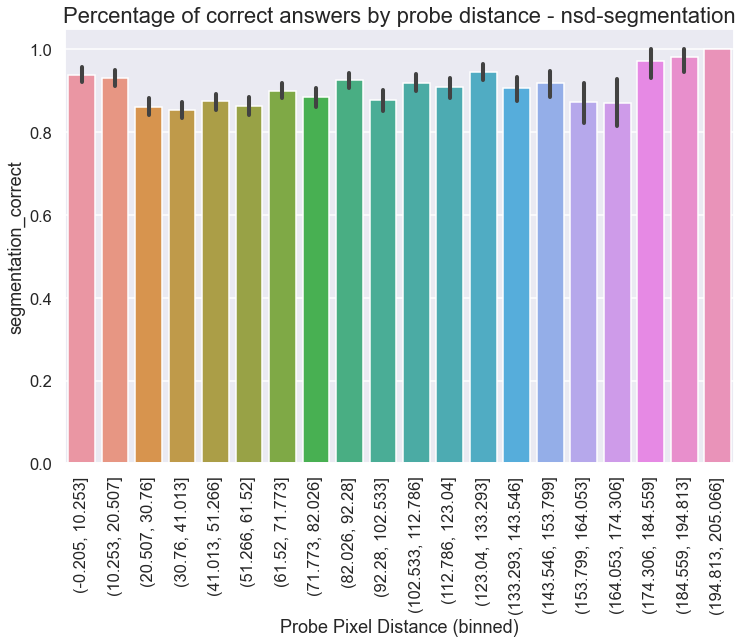

In [92]:
df["probe_distance"] = df["probe_locations"].apply(lambda x: l2_dist(x[0], x[1]))

fig, ax = plt.subplots(figsize=(12,8))
sns.barplot(x=pd.cut(df["probe_distance"], 20), y=df["segmentation_correct"])
plt.xlabel("Probe Pixel Distance (binned)")
plt.xticks(range(20), rotation=90)
plt.title(f"Percentage of correct answers by probe distance - {experimentName}", fontsize=22)
plt.show()

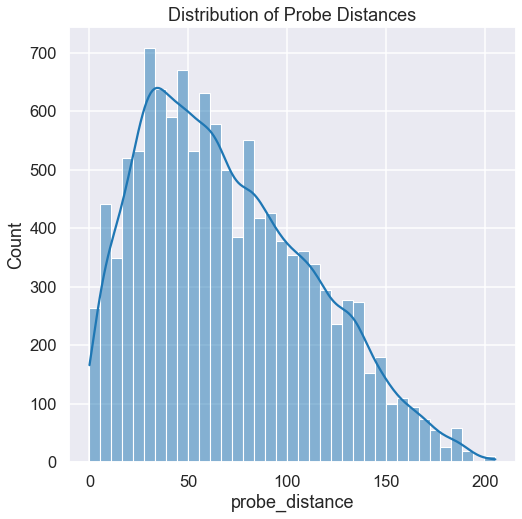

In [93]:
fig, ax = plt.subplots(figsize=(8,8))
sns.histplot(df["probe_distance"], kde=True, ax=ax)
plt.title("Distribution of Probe Distances")
plt.show()

In [94]:
def simple_regplot(
    x, y, n_std=2, n_pts=100, ax=None, scatter_kws=None, line_kws=None, ci_kws=None
):
    """ Draw a regression line with error interval. """
    ax = plt.gca() if ax is None else ax

    # calculate best-fit line and interval
    x_fit = sm.add_constant(x)
    fit_results = sm.OLS(y, x_fit).fit()

    eval_x = sm.add_constant(np.linspace(np.min(x), np.max(x), n_pts))
    pred = fit_results.get_prediction(eval_x)

    # draw the fit line and error interval
    ci_kws = {} if ci_kws is None else ci_kws
    ax.fill_between(
        eval_x[:, 1],
        pred.predicted_mean - n_std * pred.se_mean,
        pred.predicted_mean + n_std * pred.se_mean,
        alpha=0.5,
        **ci_kws,
    )
    line_kws = {} if line_kws is None else line_kws
    h = ax.plot(eval_x[:, 1], pred.predicted_mean, **line_kws)

    # draw the scatterplot
    scatter_kws = {} if scatter_kws is None else scatter_kws
    ax.scatter(x, y, c=h[0].get_color(), **scatter_kws)

    return fit_results

analysis to-do:

1. Inter-subject reliability (check consistency between repeats)
2. Check noise ceiling for individual points
3. Check worst trials -- see what the deal is
4. Look at distribution of answers

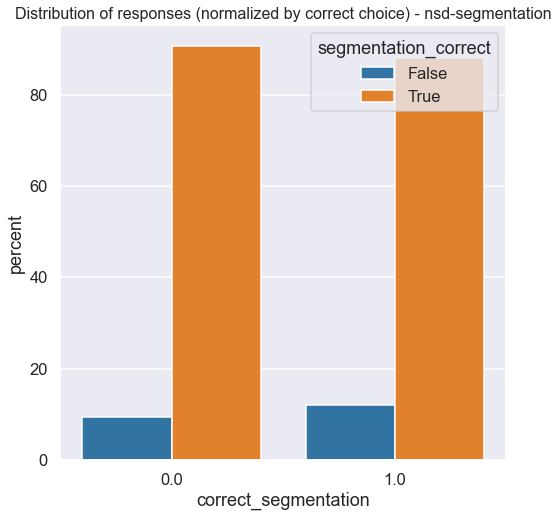

In [97]:
x="correct_segmentation"
y="segmentation_correct"

fig, ax = plt.subplots(figsize=(8, 8))
(df
.groupby(x)[y]
.value_counts(normalize=True)
.mul(100)
.rename('percent')
.reset_index()
.pipe((sns.barplot,'data'), x=x,y='percent',hue=y, ax=ax))

plt.title(f"Distribution of responses (normalized by correct choice) - {experimentName}", fontsize=16)
plt.show()


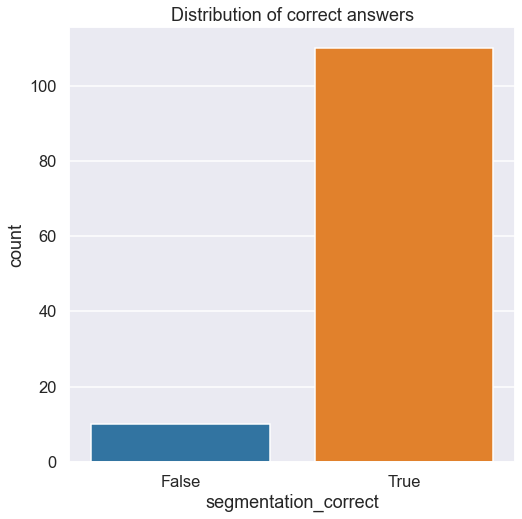

In [31]:
fig, ax = plt.subplots(figsize=(8,8))
sns.countplot(x=df["segmentation_correct"], ax=ax)
plt.title("Distribution of correct answers")
plt.show()

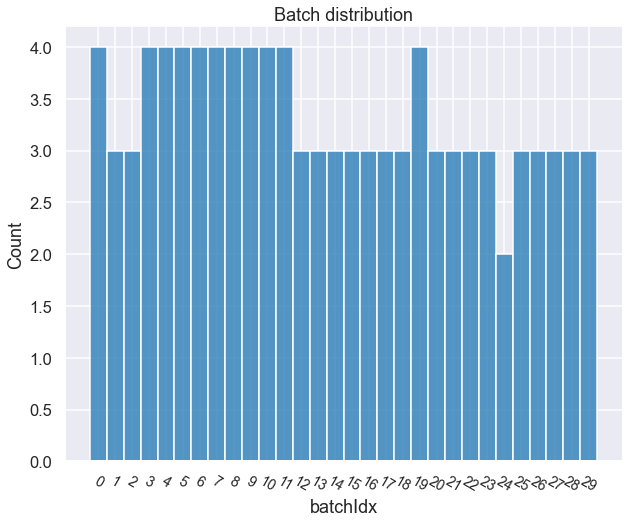

In [110]:
fig = plt.figure(figsize=(10,8))
batch_counts = df.groupby("userID")["batchIdx"].mean() # sort of hacky way to get per-
sns.histplot(x=batch_counts, stat="count", binwidth=1, bins=10, discrete=True)
plt.xticks(range(30), range(30), rotation=330, fontsize=14)
plt.title("Batch distribution")
plt.show()

## Check most difficult trials

In [111]:
def download_from_s3(url, resource_type="image"):
    s3 = boto3.resource('s3', region_name="us-east-2")
    bucket = s3.Bucket("mlve-v1")
    s3_path = url.split(".com/")[1]
    item = bucket.Object(s3_path)
    if resource_type == "image":
        file_stream = io.BytesIO()
        item.download_fileobj(file_stream)
        img = Image.open(file_stream)
        return img
    else:
        return item

Checking Trial:  https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_000.png


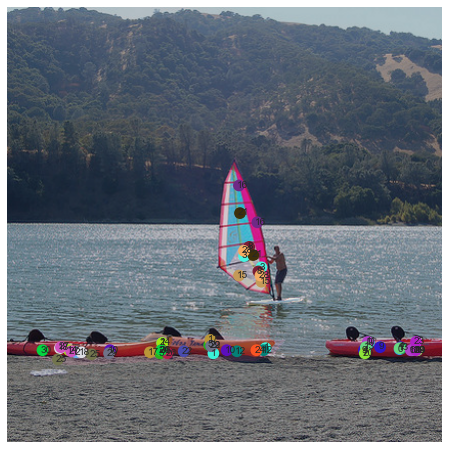

Checking Trial:  https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_001.png


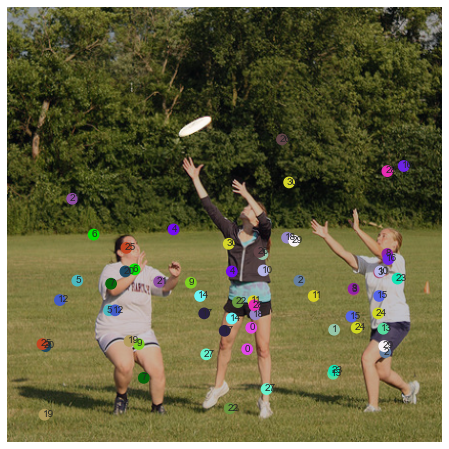

Checking Trial:  https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_002.png


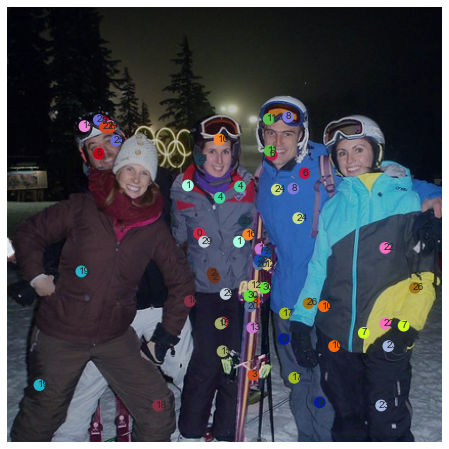

Checking Trial:  https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_003.png


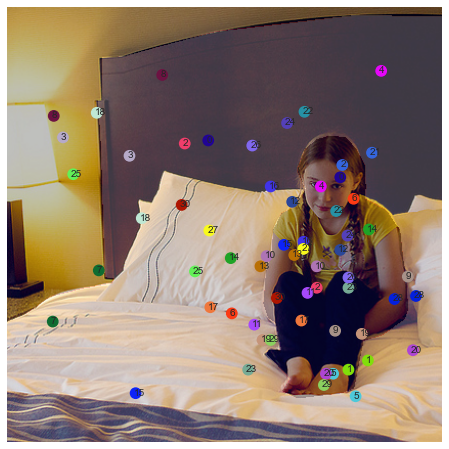

Checking Trial:  https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_004.png


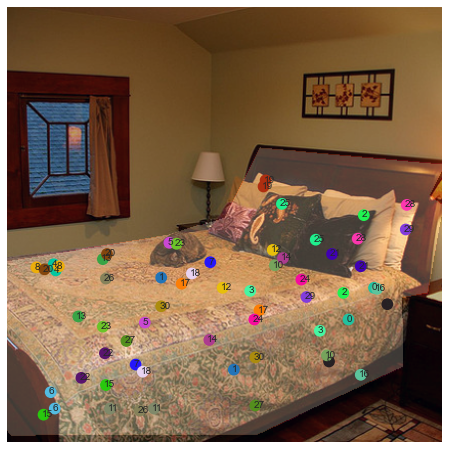

Checking Trial:  https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_005.png


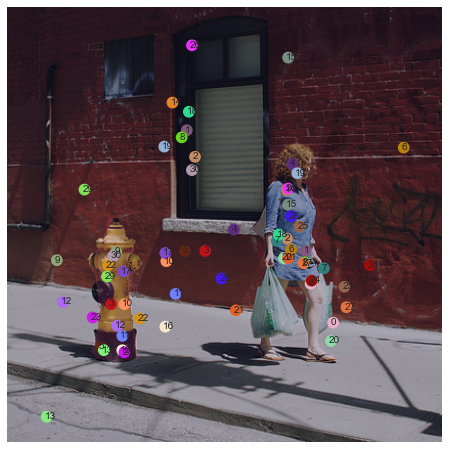

Checking Trial:  https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_006.png


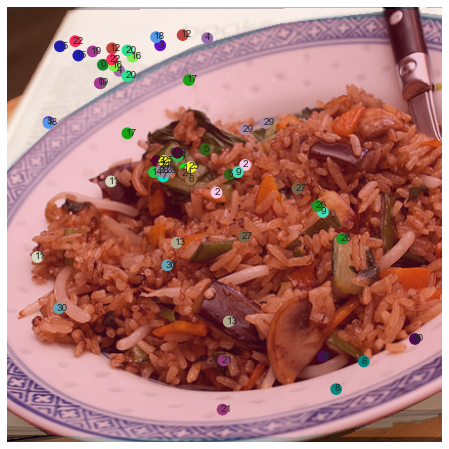

Checking Trial:  https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_007.png


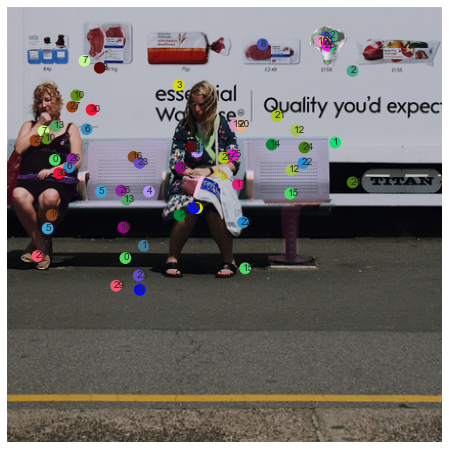

Checking Trial:  https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_008.png


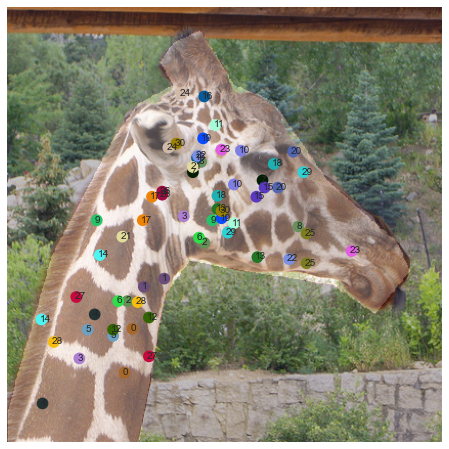

Checking Trial:  https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_009.png


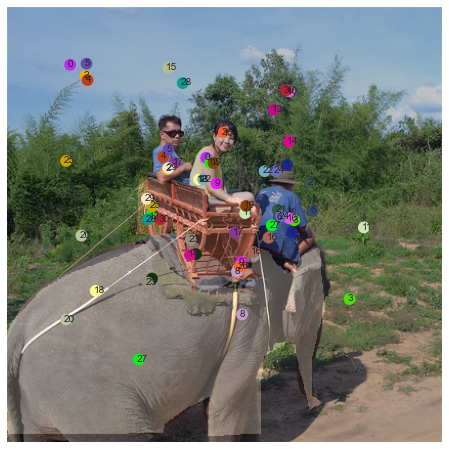

Checking Trial:  https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_010.png


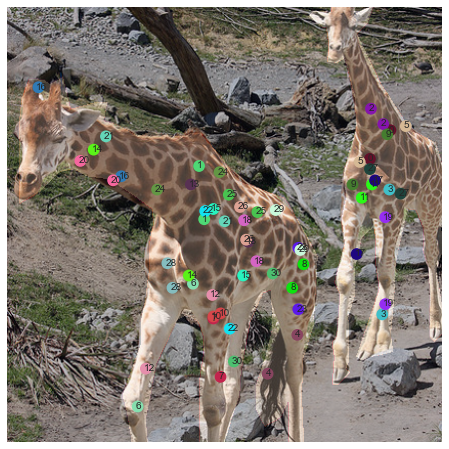

Checking Trial:  https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_011.png


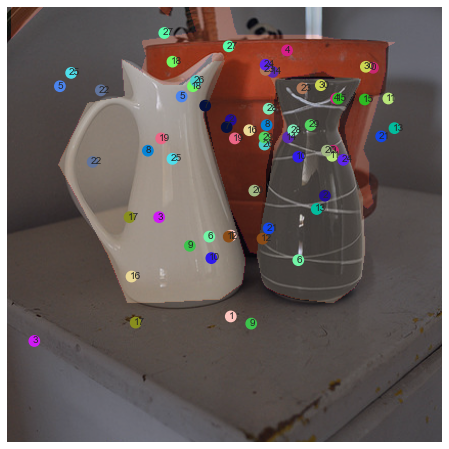

Checking Trial:  https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_012.png


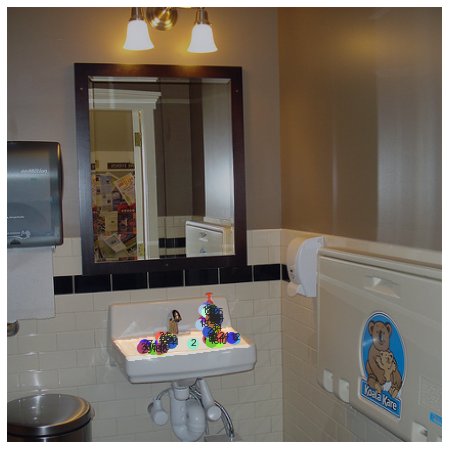

Checking Trial:  https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_013.png


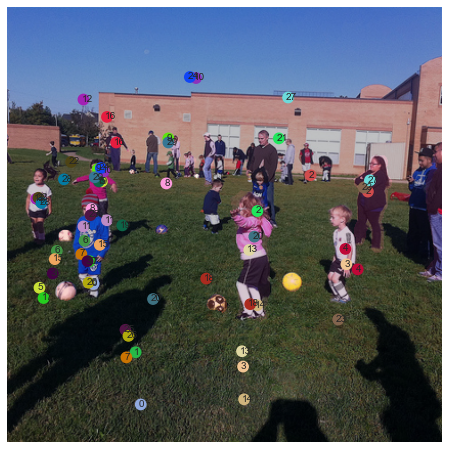

Checking Trial:  https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_014.png


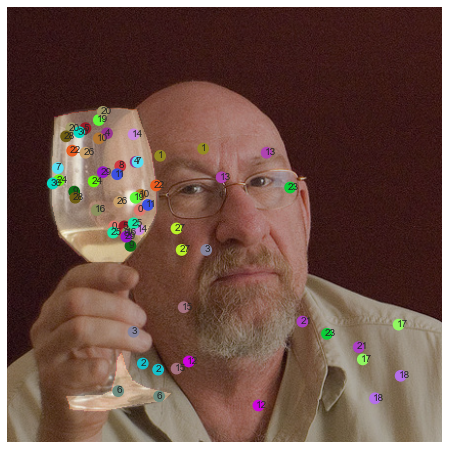

Checking Trial:  https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_015.png


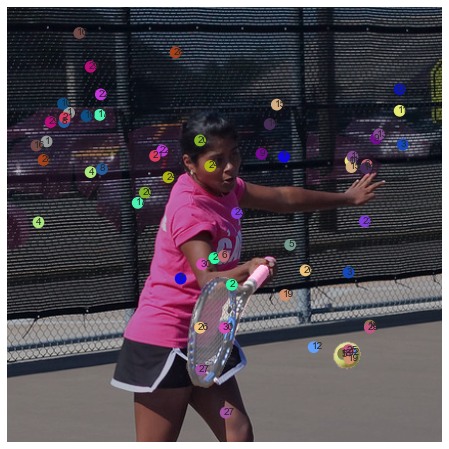

Checking Trial:  https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_016.png


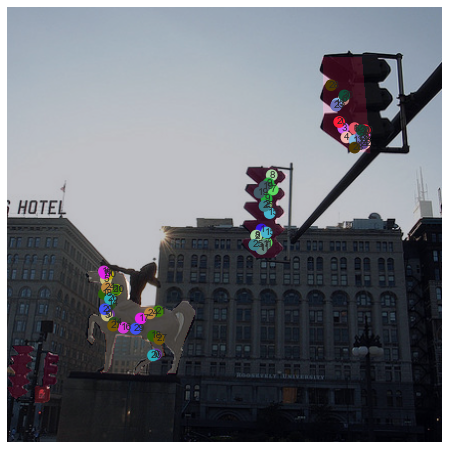

Checking Trial:  https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_017.png


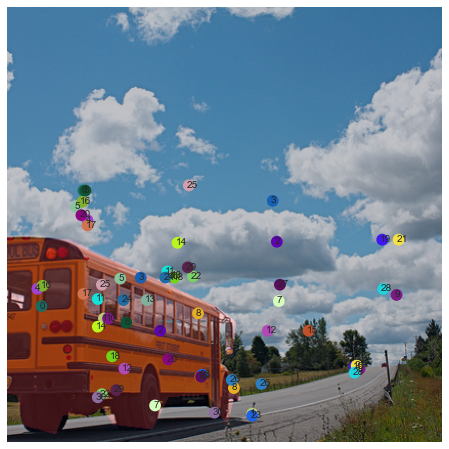

Checking Trial:  https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_018.png


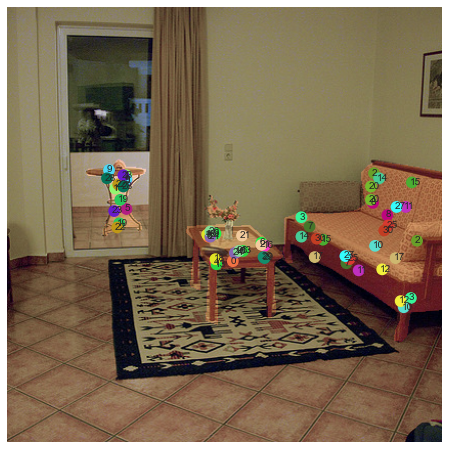

Checking Trial:  https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_019.png


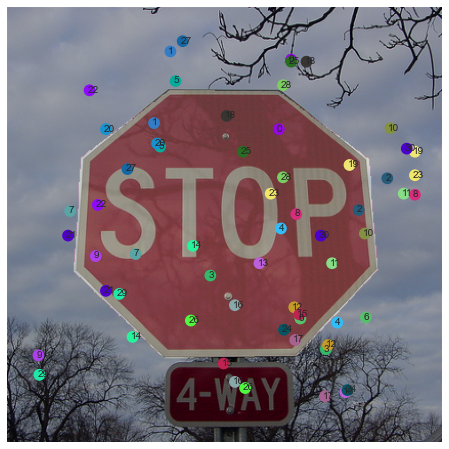

Checking Trial:  https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_020.png


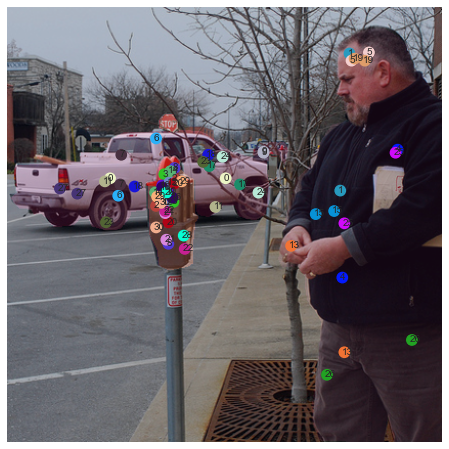

Checking Trial:  https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_021.png


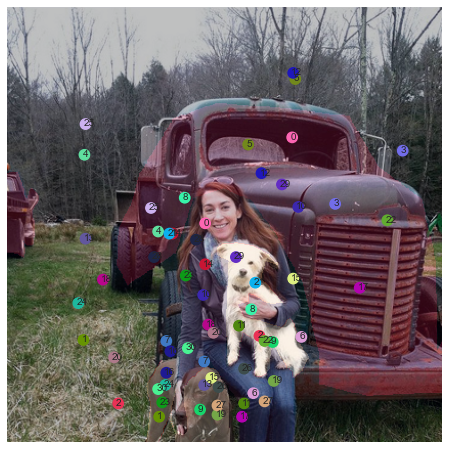

Checking Trial:  https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_022.png


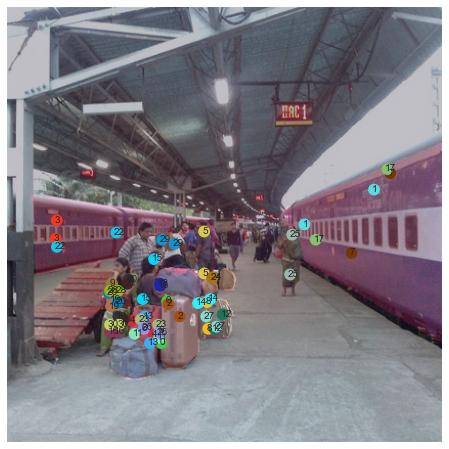

Checking Trial:  https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_023.png


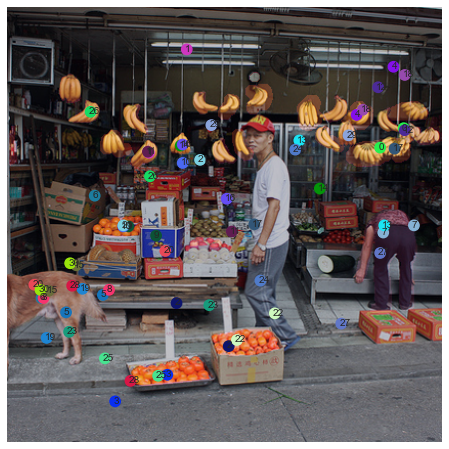

Checking Trial:  https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_024.png


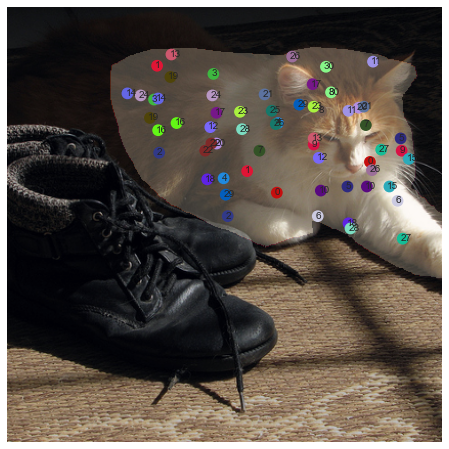

Checking Trial:  https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_025.png


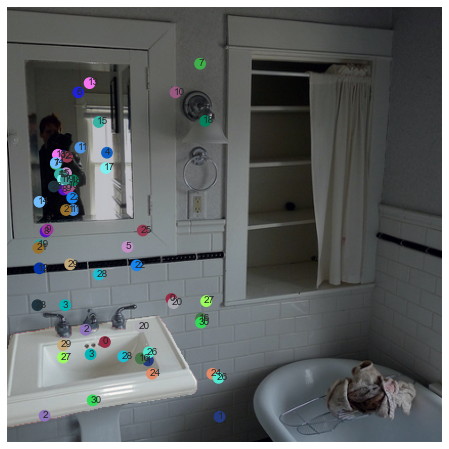

Checking Trial:  https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_026.png


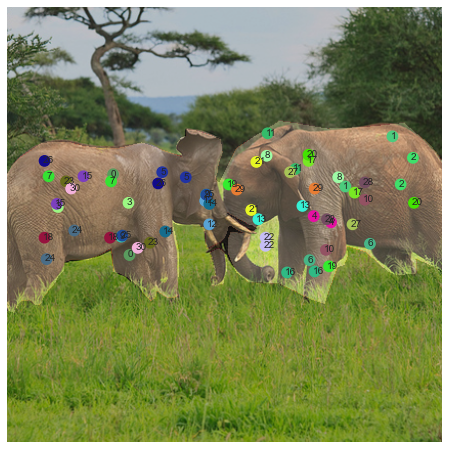

Checking Trial:  https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_027.png


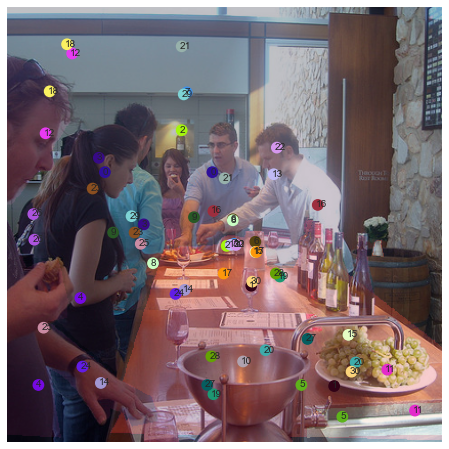

Checking Trial:  https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_028.png


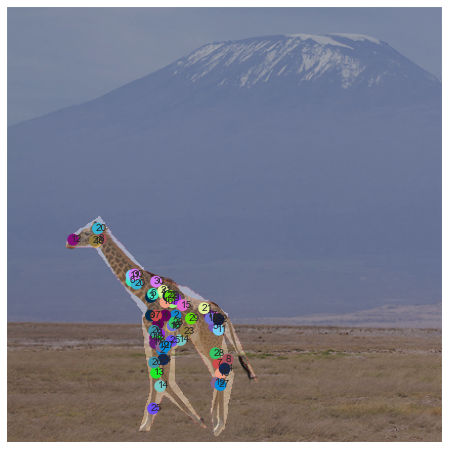

Checking Trial:  https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_029.png


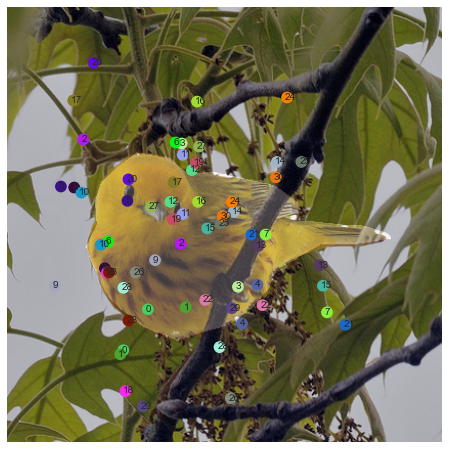

Checking Trial:  https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_030.png


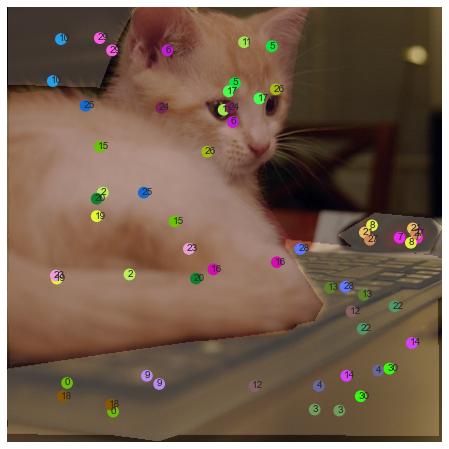

Checking Trial:  https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_031.png


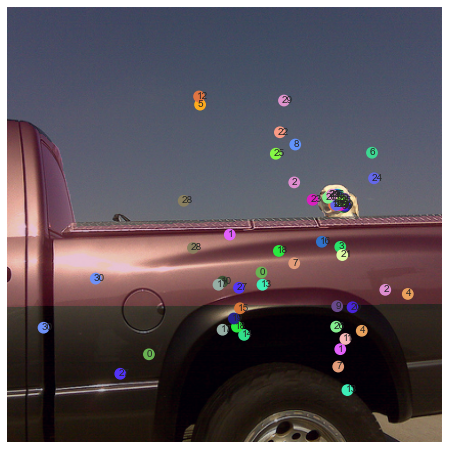

Checking Trial:  https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_032.png


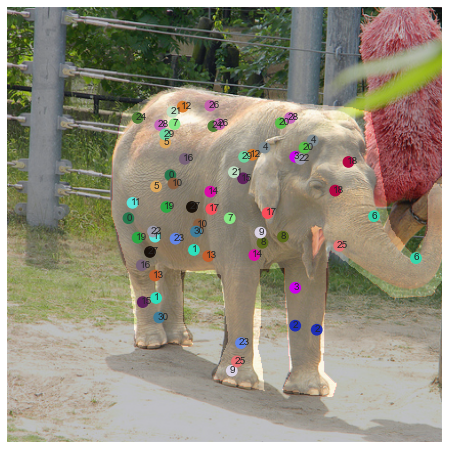

Checking Trial:  https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_033.png


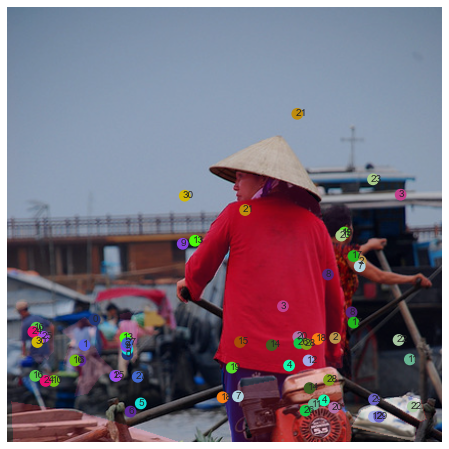

Checking Trial:  https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_034.png


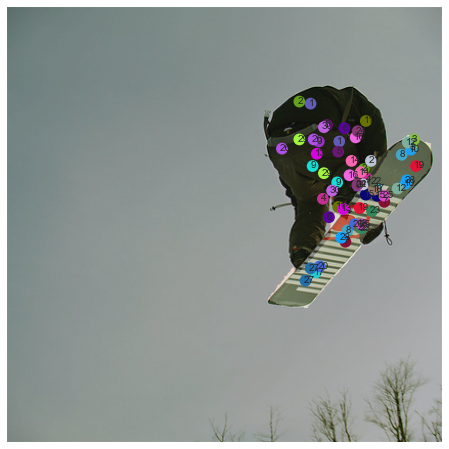

Checking Trial:  https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_035.png


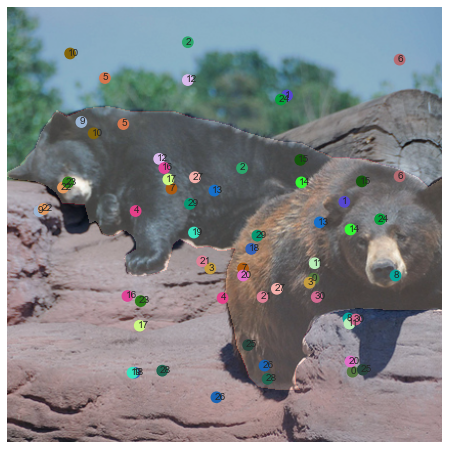

Checking Trial:  https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_036.png


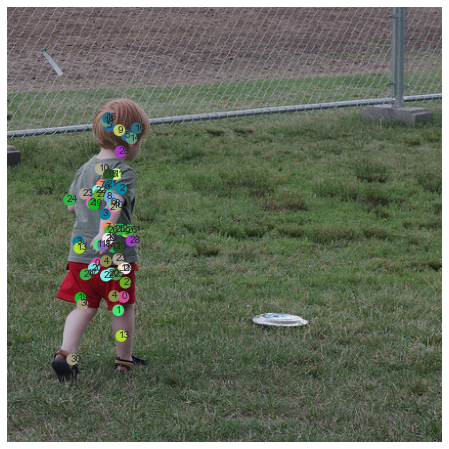

Checking Trial:  https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_037.png


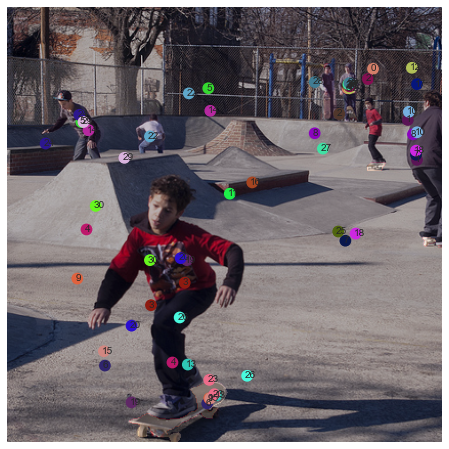

Checking Trial:  https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_038.png


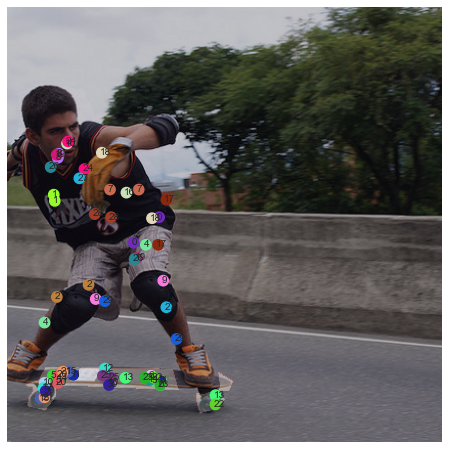

Checking Trial:  https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_039.png


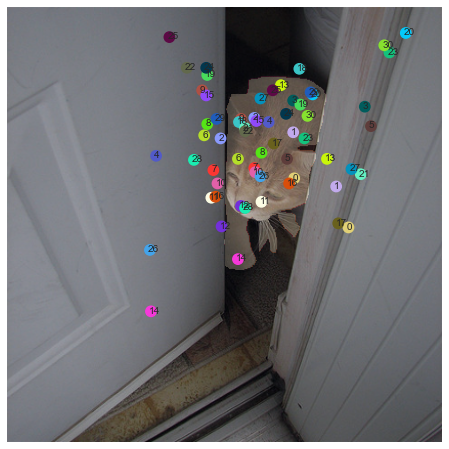

Checking Trial:  https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_040.png


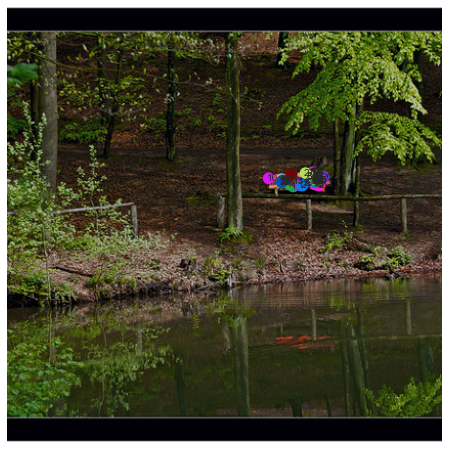

Checking Trial:  https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_041.png


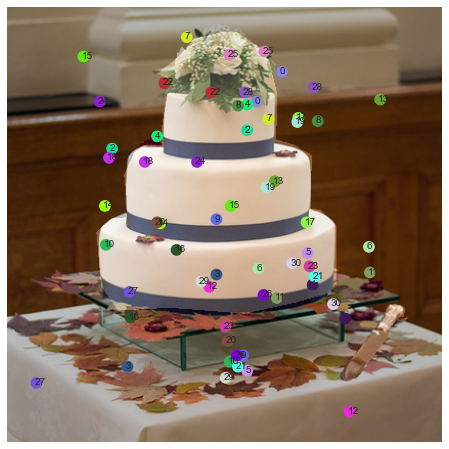

Checking Trial:  https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_042.png


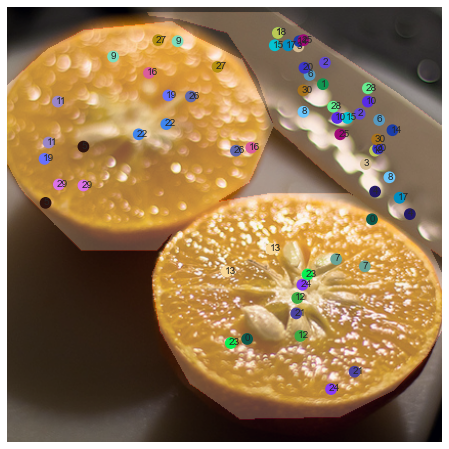

Checking Trial:  https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_043.png


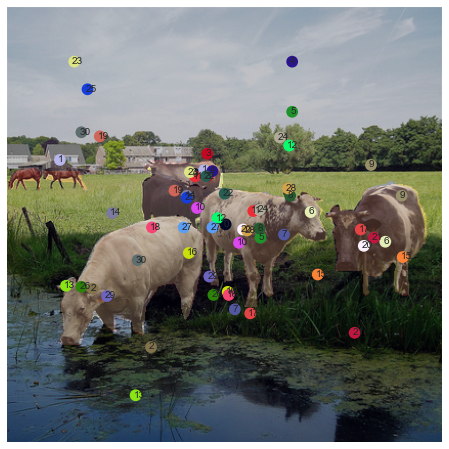

Checking Trial:  https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_044.png


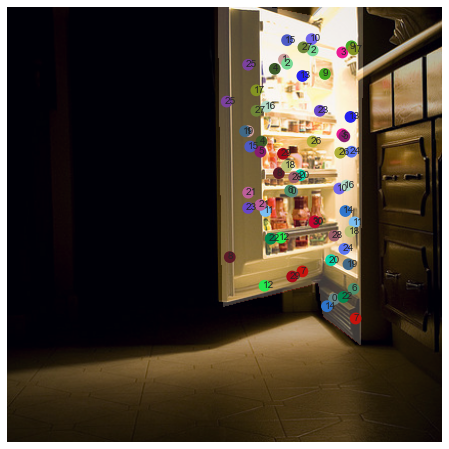

Checking Trial:  https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_045.png


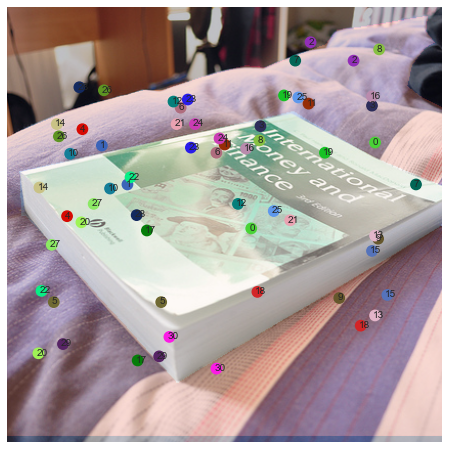

Checking Trial:  https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_046.png


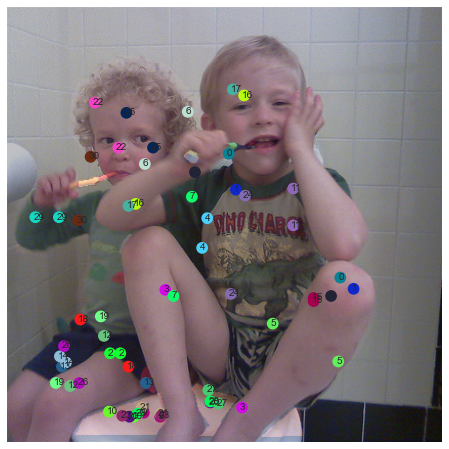

Checking Trial:  https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_047.png


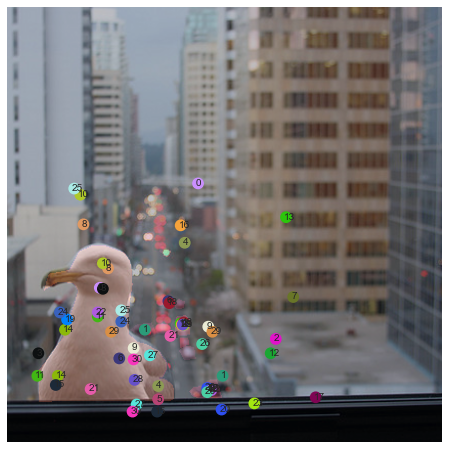

Checking Trial:  https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_048.png


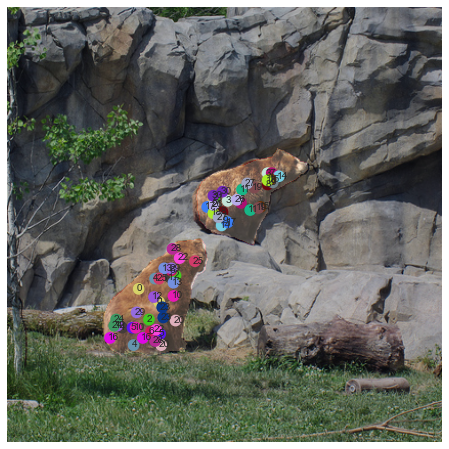

Checking Trial:  https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_049.png


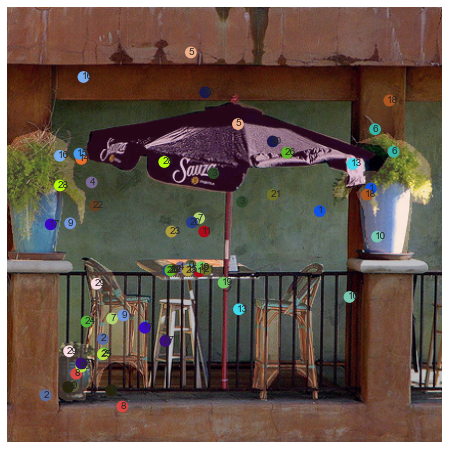

Checking Trial:  https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_050.png


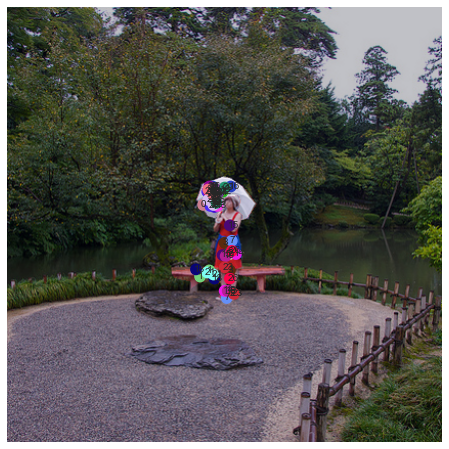

Checking Trial:  https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_051.png


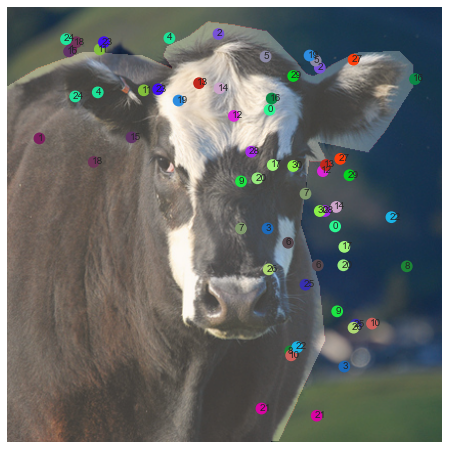

Checking Trial:  https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_052.png


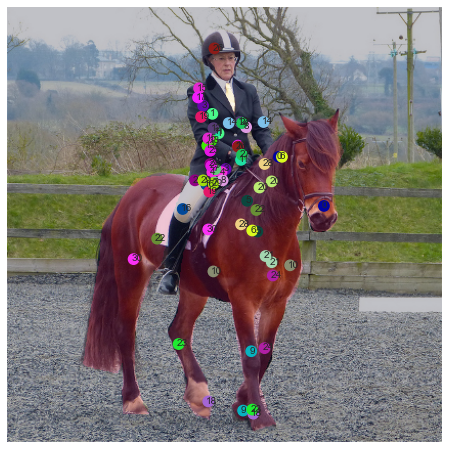

Checking Trial:  https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_053.png


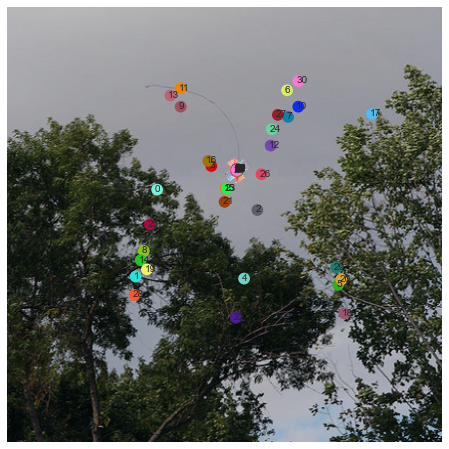

Checking Trial:  https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_054.png


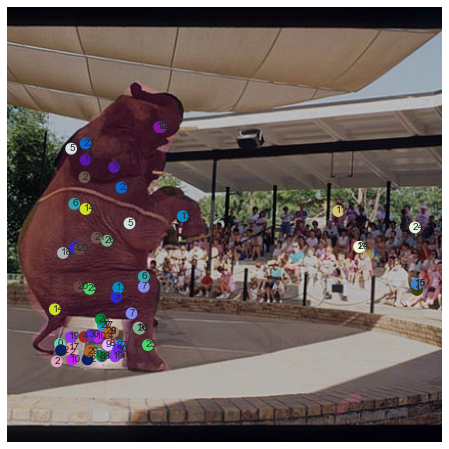

Checking Trial:  https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_055.png


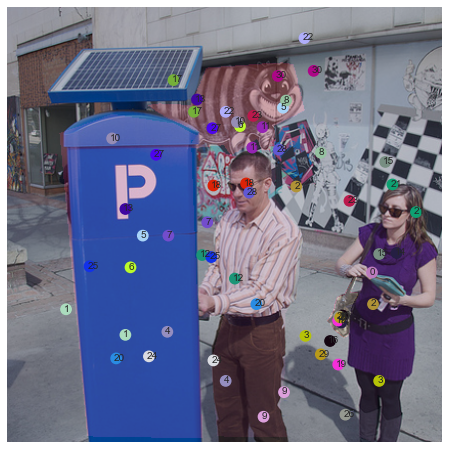

Checking Trial:  https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_056.png


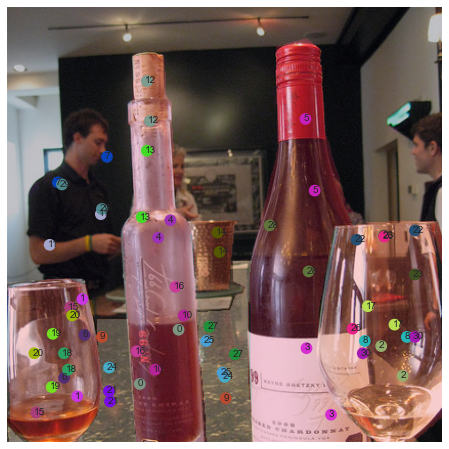

Checking Trial:  https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_057.png


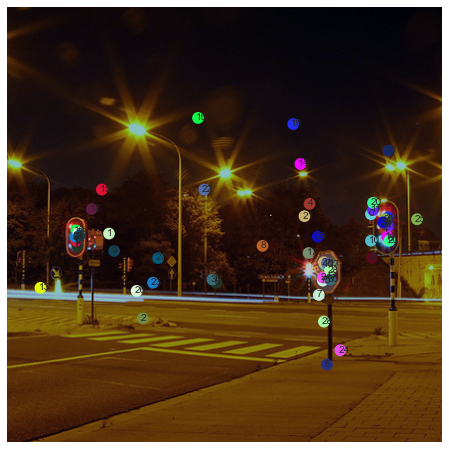

Checking Trial:  https://mlve-v1.s3.us-east-2.amazonaws.com/nsd/images/image_058.png


KeyboardInterrupt: 

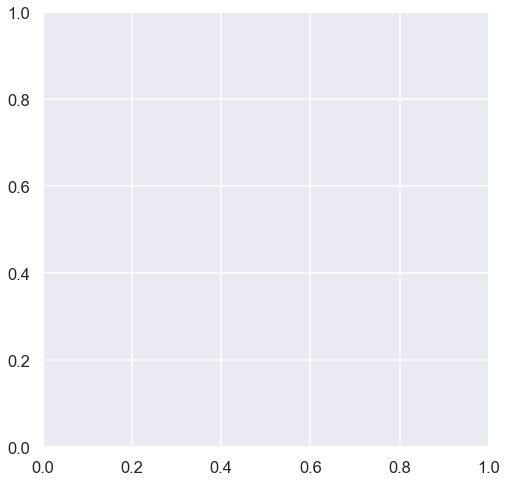

In [141]:
def get_segmentation(stimulus_url):
    mask_url = stimulus_url.replace("image", "mask")
    mask = download_from_s3(mask_url)
    mask = mask.convert("L")
    return np.array(mask)


def points_in_circle(radius, x0, y0):
    xs = np.arange(x0 - radius, x0 + radius + 1)
    ys = np.arange(y0 - radius, y0 + radius + 1)
    x, y = np.where((xs[:, np.newaxis] - x0) ** 2 + (ys - y0) ** 2 <= radius ** 2)
    for x, y in zip(xs[x], ys[y]):
        yield (x, y)

    return

def test_points():
    cpoints = []
    for points in points_in_circle(15, 0, 0):
        cpoints.append(points)

    cpoints = np.array(cpoints)
    plt.scatter(cpoints[:, 0], cpoints[:, 1])
    plt.xlim(-512, 512)
    plt.ylim(-512, 512)
    plt.show()
    
def check_probe_overlap(probe_loc, mask):
    """
    Draw a circle of radius R at center P.
    Check if any pixel in the circle has a different pixel value
    If yes, return True, otherwise return False
    """
    pixel_val = mask[probe_loc[1], probe_loc[0]]
    overlaps = 0
    for points in points_in_circle(10, probe_loc[1], probe_loc[0]):
        if mask[points[1], points[0]] != pixel_val:
            overlaps += 1
    
    probe_area = np.pi * (10**2) 
    if overlaps / probe_area > 0.25:
        return True
    return False

def random_color():
    r = lambda: np.random.randint(0,255)
    return '#%02X%02X%02X' % (r(),r(),r())

def plot_probe_locations(ax, df, url, probe_size=5):
    trials = df.loc[df["imageURL"] == url]
    probe_locations = set([tuple(((x[0][0], x[0][1]), (x[1][0], x[1][1]))) for x in trials["probeLocations"]])
    for i, probe_pair in enumerate(probe_locations):
        color = random_color()
        probe_left = plt.Circle(probe_pair[0], probe_size, color=color)
        probe_right = plt.Circle(probe_pair[1], probe_size, color=color)
        
        offset = probe_size // 2
        ax.add_patch(probe_left)
        ax.add_patch(probe_right)
        ax.text(probe_pair[0][0] - offset, probe_pair[0][1] + offset, str(i), fontsize=10) 
        ax.text(probe_pair[1][0] - offset, probe_pair[1][1] + offset, str(i), fontsize=10) 
        
    return ax
     
def check_trial_probe_overlap(trial, ax):
    img_url = trial["stimulus"]
    mask = get_segmentation(img_url)
    img = download_from_s3(img_url)
    
    probe_locs = trial["probeLocations"]
    probe_ids = trial["probeIDs"]
    
    # probe_overlaps = check_probe_overlap(probe, mask)
    # if probe_overlaps:  
    ax.axis("off")
    ax.imshow(img)
    ax.imshow(mask, alpha=0.25)
    ax = plot_probe_locations(ax, df, str(trial["stimulus"]))
    return ax


for _, trials in df.groupby("stimulus"):
    fig = plt.figure(figsize=(8,8))
    ax = plt.subplot()
    trial = trials.iloc[0]
    print("Checking Trial: ", _)
    ax = check_trial_probe_overlap(trial, ax)
    
    plt.show()
    plt.close()

In [ ]:
if dataset in SYNTHETIC_DATASETS:
    temp_df = df[df["depth_correct"].notna()]
    temp_df = temp_df[temp_df["segmentation_correct"] == False]

    trials_ranked = temp_df.groupby("stimulus")["depth_correct"].mean()
    num_participants = temp_df.groupby("stimulus")["depth_correct"].count()
    trials_ranked = trials_ranked.sort_values()

    for i in range(10):
        url = str(trials_ranked.index[i])
        print(url)
        index = list(num_participants.keys()).index(url)
        participants = num_participants[index]
        img = download_from_s3(url)
        fig, ax = plt.subplots(1, 1, figsize=(10, 10))
        plt.axis("off")
        ax.imshow(np.array(img), cmap="gray")
        ax = plot_probe_locations(ax, temp_df, url)
        score = trials_ranked[i]
        
        plt.title(f"Depth accuracy: {score:0.3f} ({participants} responses)")
        plt.show()

In [ ]:
if dataset in SYNTHETIC_DATASETS:
    temp_df = df[df["depth_correct"].notna()]
    temp_df = temp_df[temp_df["segmentation_correct"] == True]

    trials_ranked = temp_df.groupby("stimulus")["depth_correct"].mean()
    num_participants = temp_df.groupby("stimulus")["depth_correct"].count()
    trials_ranked = trials_ranked.sort_values()

    for i in range(10):
        url = str(trials_ranked.index[i])
        print(url)
        index = list(num_participants.keys()).index(url)
        participants = num_participants[index]
        img = download_from_s3(url)
        fig, ax = plt.subplots(1, 1, figsize=(10, 10))
        plt.axis("off")
        ax.imshow(np.array(img), cmap="gray")
        ax = plot_probe_locations(ax, temp_df, url)
        score = trials_ranked[i]
        
        plt.title(f"Depth accuracy: {score:0.3f} ({participants} responses)")
        plt.show()

## Check intra-user consistency

# Split half analysis

In [ ]:
# Split data by user
# For each trial correlate half and half splits
from scipy.stats import pearsonr, sem

def calculate_splithalf(split_num):
    """
    split_num: int: number of participants to sample for each half (ie; if split_num is 5, you choose 5 people for group A and 5 for group B)
    """
    splt_df = df[df["isDuplicate"] != True]
    splt_df = splt_df[splt_df["attentionCheck"] == False]
    trials = [x[1].values[:] for x in splt_df.groupby("imageURL")["segmentation_correct"]]
    trials = np.stack(trials, axis=0) # Gives us a (n_trials, m_participants) array of errors (in our case [100, 38])

    n_participants = trials.shape[1]
    
    pearson_rs = []
    spb_rs = [] # Spearman-Brown corrected Pearson R values
    p_vals = []

    # Take 1000 random splits of participants
    splits = 1000

    for i in range(splits):
        idxs = np.random.choice(range(n_participants), split_num * 2, replace=False)
        a_idxs, b_idxs = np.split(idxs, 2)
        
        a_errs = np.nanmean(trials[:, a_idxs], axis=1) # average errors across images
        b_errs = np.nanmean(trials[:, b_idxs], axis=1)

        stat, p_val = pearsonr(a_errs, b_errs)
        p_vals.append(p_val)
        pearson_rs.append(stat)
        
        # Spearman-Brown correction = (n*p)/(1 + (n-1)*p) 
        # For split-half n=2 tests
        spb_rs.append((2 * stat) / (1 + stat))

#     print(f"Testing split of {split_num} participants against remainder of population."\
#           f"\nR\t=\t{np.mean(reliabilities)},"\
#           f"\nStd Err\t=\t{sem(reliabilities)}"
#           f"\nP-value\t=\t{np.mean(p_vals)}")
    
    return np.mean(pearson_rs), np.mean(spb_rs)

fig = plt.figure(figsize=(12,8))
rs = []
spbs = []
nparticipants = len(df["userID"].unique()) // 2
split_nums = list(range(2, nparticipants))
print(nparticipants)
for split_num in split_nums:
    r, spb = calculate_splithalf(split_num)
    spbs.append(spb)
    rs.append(r)

plt.yticks(fontsize=22)
plt.xticks(range(2, nparticipants), [n * 2 for n in split_nums], fontsize=22)
plt.plot(split_nums, rs, lw=3, label="Pearson R")
plt.plot(split_nums, spbs, lw=3, label="Spearman-Brown Corrected")
plt.xlabel("N Participants", fontsize=22)
plt.ylabel("Reliability", fontsize=22)
plt.legend(fontsize=18)
plt.title("Split Half Reliability", fontsize=22)
plt.suptitle(f"{experimentName}")
plt.show()

# Check self-consistency

In [166]:
duplicates = df[df["isDuplicate"] == True]
total = 0
all_inconsistencies = []
for user, trials in duplicates.groupby("userID"):
    user_inconsistencies = []
    for stimulus, stim_trials in trials.groupby("stimulus"):
        correct = df[(df["userID"] == user) & (df["stimulus"] == stimulus)]["segmentation_correct"].mean()
        total += 1
        if correct != 0 and correct != 1:
            user_inconsistencies.append(1)
    all_inconsistencies.append(sum(user_inconsistencies))

<BarContainer object of 100 artists>

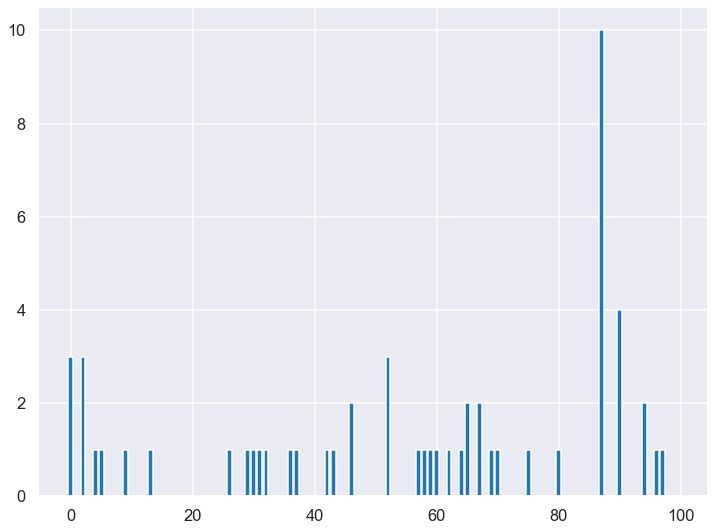

In [170]:
figure = plt.figure(figsize=(12, 9))
total_users = len(all_inconsistencies)
plt.bar(range(total_users), all_inconsistencies)

In [173]:
duplicates = df[df["isDuplicate"] == True]
total = 0
all_inconsistencies = []
for user, trials in duplicates.groupby("userID"):
    user_inconsistencies = []
    for stimulus, stim_trials in trials.groupby("stimulus"):
        correct = df[(df["userID"] == user) & (df["stimulus"] == stimulus)]["correct_segmentation"].mean()
        total += 1
        if correct != 0 and correct != 1:
            user_inconsistencies.append(1)
    all_inconsistencies.append(sum(user_inconsistencies))

<BarContainer object of 100 artists>

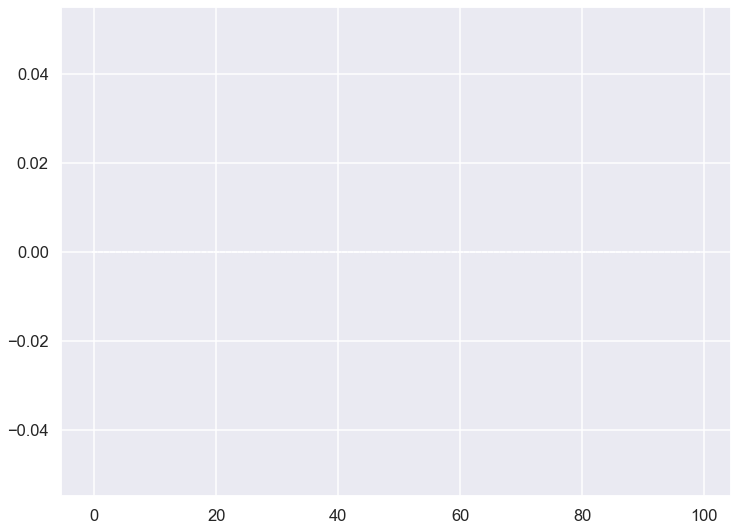

In [174]:
figure = plt.figure(figsize=(12, 9))
total_users = len(all_inconsistencies)
plt.bar(range(total_users), all_inconsistencies)